In [12]:
import numpy as np
import matplotlib.pyplot as plt
import os 
from itertools import groupby
from operator import itemgetter
Fs = 56e6


In [13]:
def getIQ(workingDirectory = None):
    if workingDirectory is None:
        workingDirectory = os.getcwd()
    files = os.listdir(workingDirectory)
    IQFiles = []
    for file in files:
        if file.endswith('.iq'):
            IQFiles.append(file)
    input(str(IQFiles)+"\nDoes this look good? \nPress any button to continue!")
    return IQFiles


def timeDomainPlotter(IQsamples,iq):
    batchAna = 1000000
    start = 0 
    for i in range(len(IQsamples)//batchAna+1):
        x = IQsamples[start:start + batchAna]
        framesIndex = frameFinder(x)
        
        plt.figure(figsize=(30, 3), dpi=80)
        plt.plot(np.linspace(start,  start+len(x), len(x))/Fs,np.abs(x))
        try: 
            plt.stem(np.add(framesIndex.flatten(),[start]*len(framesIndex)*2)/Fs, [.4]*len(framesIndex.flatten()) ,'r')
        except:
            plt.close()
            continue
        plt.xlabel("time (s)")
        plt.ylabel("amplitude")
        plt.title(iq)
        # # lt.grid(True)
        plt.show()
        plt.close()

        FFTPlotter(x,framesIndex)
        start += batchAna


def frameFinder(samples):
    test_list = np.nonzero(samples)
    framesIndex = []
    for k, g in groupby(enumerate(test_list[0]), lambda ix: ix[0]-ix[1]):
        temp = list(map(itemgetter(1), g))
        if len(temp)< 1000:
            continue
        framesIndex.append([temp[0],temp[-1]])
    return np.array(framesIndex)

def FFTPlotter(samples,framesIndex):
    frames = []
    for i,j in framesIndex:
        frames.append(samples[i:j])

    for idx,frame in enumerate(frames):
        PSD = (np.abs(np.fft.fft(frame))/len(frame))**2
        PSD_log = 10.0*np.log10(PSD)
        PSD_shifted = np.fft.fftshift(PSD_log)
        plt.figure(figsize=(20, 2), dpi=100)

        plt.subplot(1,3,1)
        plt.plot(np.abs(frame))
        plt.subplot(1,3,2)
        plt.plot(PSD_shifted)
        plt.subplot(1,3,3)
        plt.plot(np.real(frame),np.imag(frame),'.')
        plt.suptitle("frame #"+ str(idx))
        plt.show()


RawIQ_ring_1_Acq1_sampling_rate56000000.0gain40_thre_0.1.iq :  207


<ipython-input-13-c73bb797d565>:23: UserWarning: In Matplotlib 3.3 individual lines on a stem plot will be added as a LineCollection instead of individual lines. This significantly improves the performance of a stem plot. To remove this warning and switch to the new behaviour, set the "use_line_collection" keyword argument to True.
  plt.stem(np.add(framesIndex.flatten(),[start]*len(framesIndex)*2)/Fs, [.4]*len(framesIndex.flatten()) ,'r')


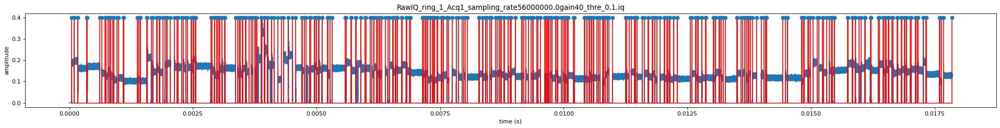

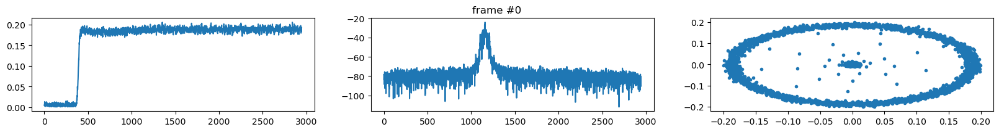

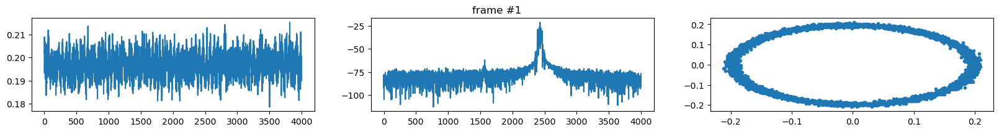

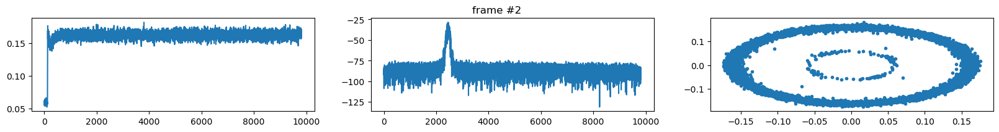

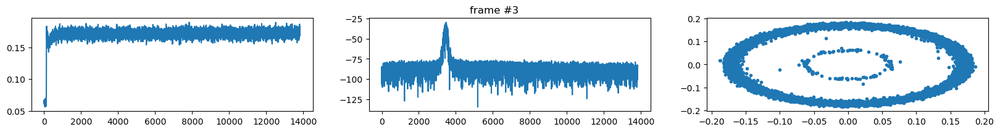

...

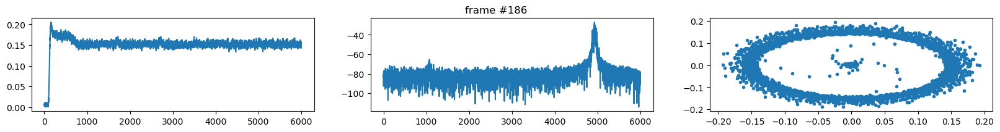

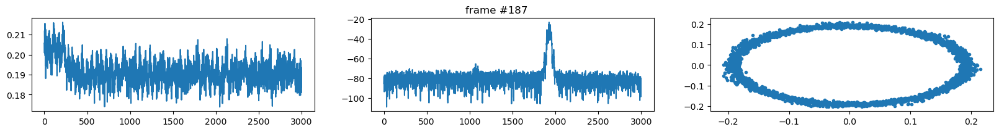

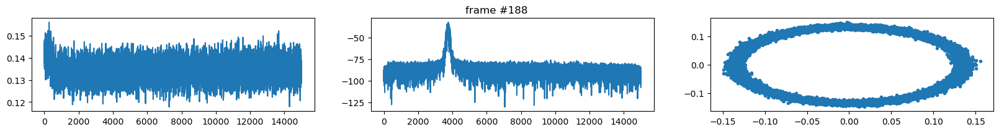

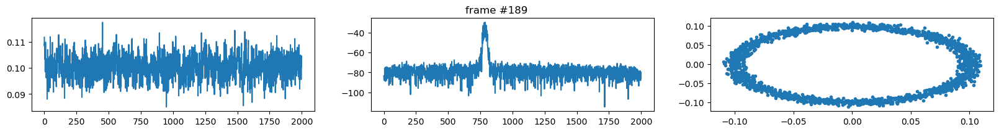

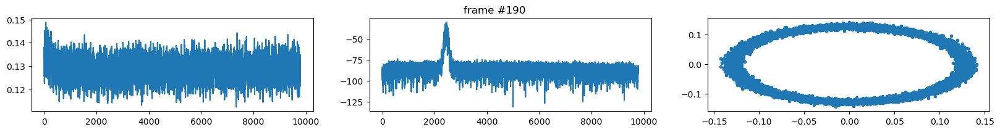

<ipython-input-13-c73bb797d565>:23: UserWarning: In Matplotlib 3.3 individual lines on a stem plot will be added as a LineCollection instead of individual lines. This significantly improves the performance of a stem plot. To remove this warning and switch to the new behaviour, set the "use_line_collection" keyword argument to True.
  plt.stem(np.add(framesIndex.flatten(),[start]*len(framesIndex)*2)/Fs, [.4]*len(framesIndex.flatten()) ,'r')


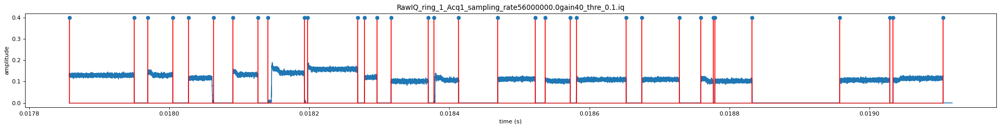

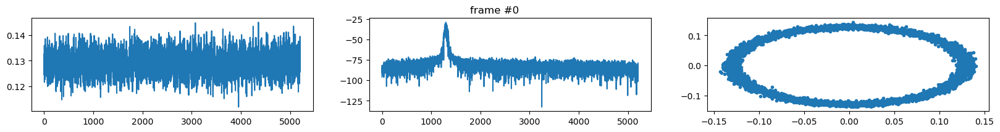

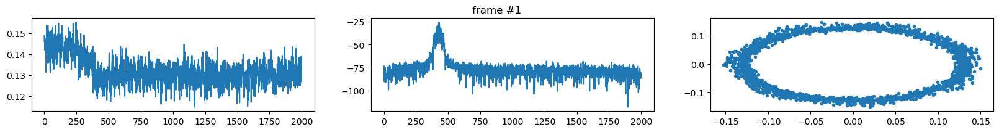

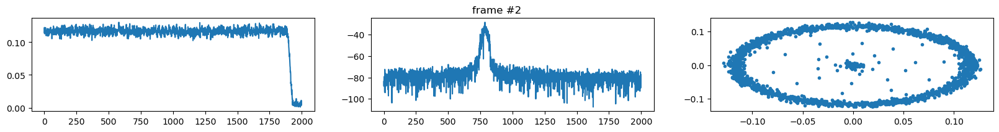

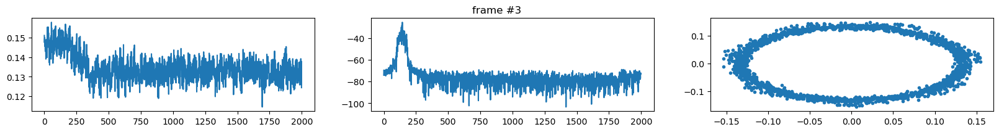

...

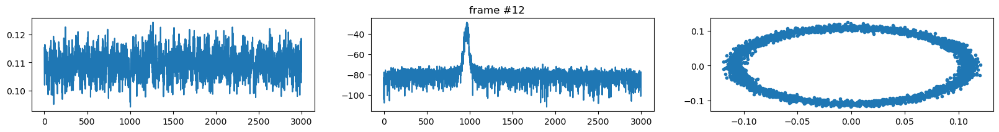

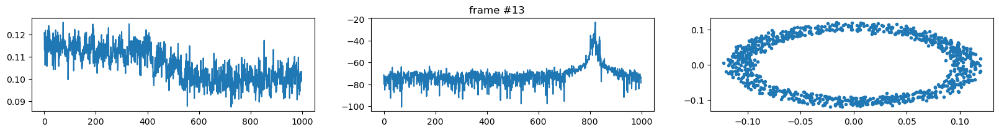

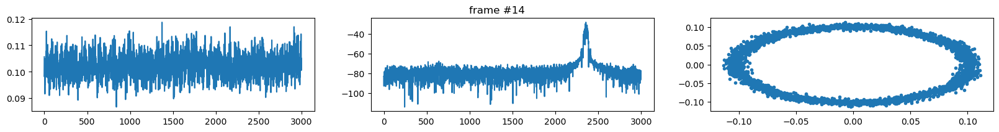

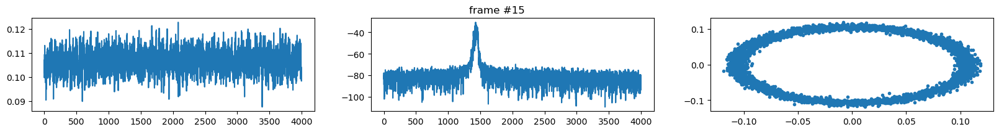

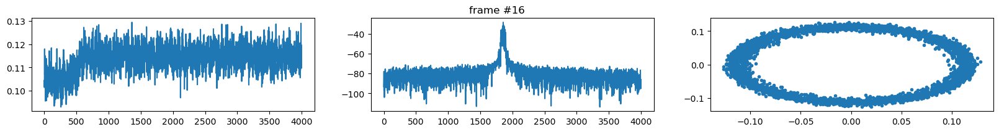

RawIQ_Ring_1_Acq1_sampling_rate60000000.0gain40_thre_0.1.iq :  1


<ipython-input-13-c73bb797d565>:23: UserWarning: In Matplotlib 3.3 individual lines on a stem plot will be added as a LineCollection instead of individual lines. This significantly improves the performance of a stem plot. To remove this warning and switch to the new behaviour, set the "use_line_collection" keyword argument to True.
  plt.stem(np.add(framesIndex.flatten(),[start]*len(framesIndex)*2)/Fs, [.4]*len(framesIndex.flatten()) ,'r')


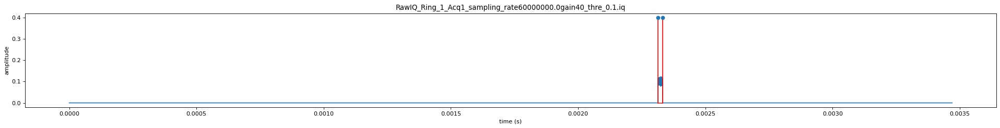

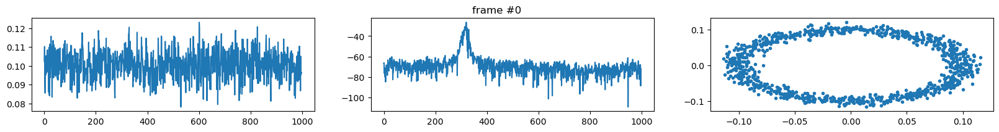

RawIQ_ring_1_Acq2_sampling_rate56000000.0gain40_thre_0.1.iq :  184


<ipython-input-13-c73bb797d565>:23: UserWarning: In Matplotlib 3.3 individual lines on a stem plot will be added as a LineCollection instead of individual lines. This significantly improves the performance of a stem plot. To remove this warning and switch to the new behaviour, set the "use_line_collection" keyword argument to True.
  plt.stem(np.add(framesIndex.flatten(),[start]*len(framesIndex)*2)/Fs, [.4]*len(framesIndex.flatten()) ,'r')


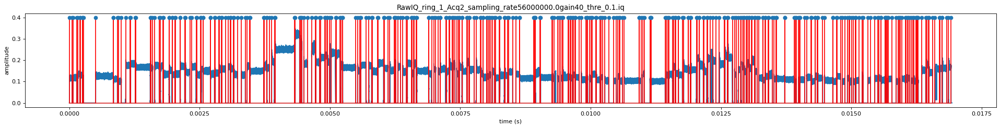

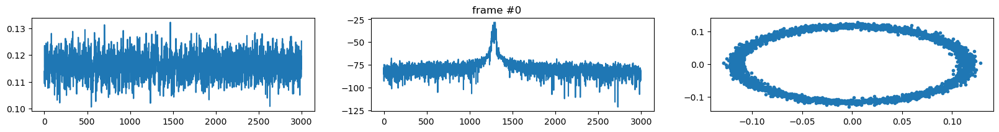

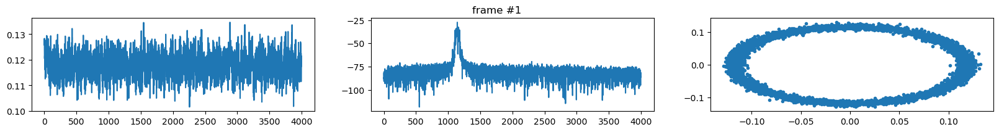

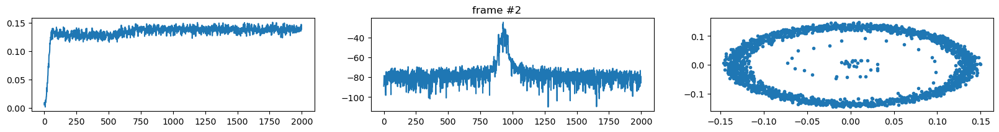

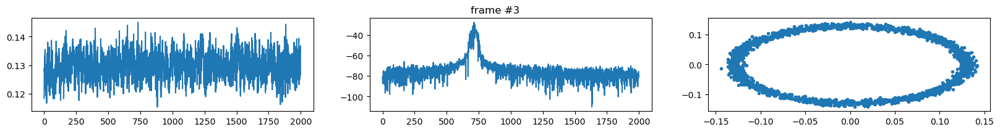

...

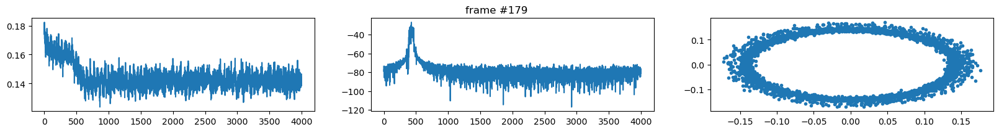

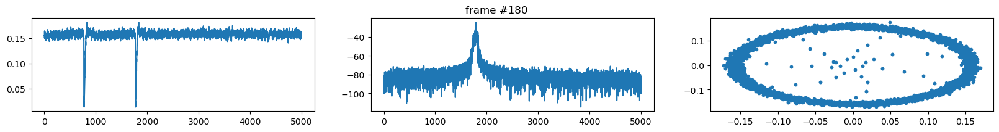

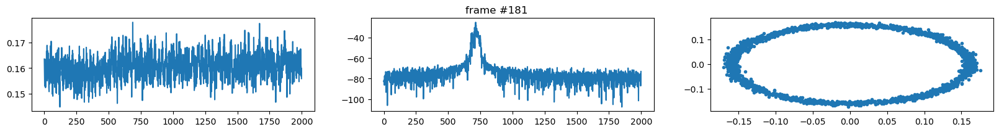

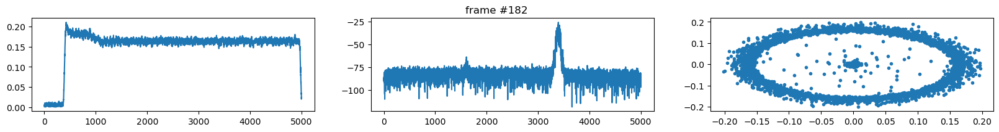

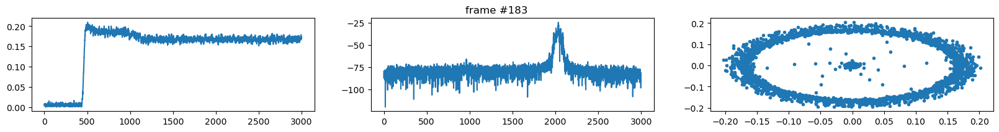

RawIQ_ring_1_Acq2_sampling_rate60000000.0gain40_thre_0.1.iq :  0


<ipython-input-13-c73bb797d565>:23: UserWarning: In Matplotlib 3.3 individual lines on a stem plot will be added as a LineCollection instead of individual lines. This significantly improves the performance of a stem plot. To remove this warning and switch to the new behaviour, set the "use_line_collection" keyword argument to True.
  plt.stem(np.add(framesIndex.flatten(),[start]*len(framesIndex)*2)/Fs, [.4]*len(framesIndex.flatten()) ,'r')


RawIQ_ring_1_Acq3_sampling_rate56000000.0gain40_thre_0.1.iq :  192


<ipython-input-13-c73bb797d565>:23: UserWarning: In Matplotlib 3.3 individual lines on a stem plot will be added as a LineCollection instead of individual lines. This significantly improves the performance of a stem plot. To remove this warning and switch to the new behaviour, set the "use_line_collection" keyword argument to True.
  plt.stem(np.add(framesIndex.flatten(),[start]*len(framesIndex)*2)/Fs, [.4]*len(framesIndex.flatten()) ,'r')


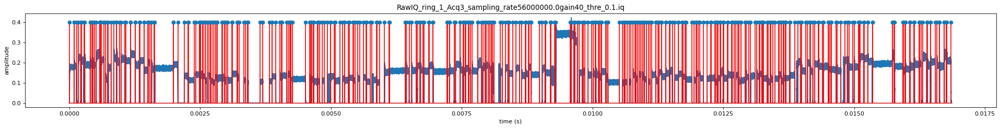

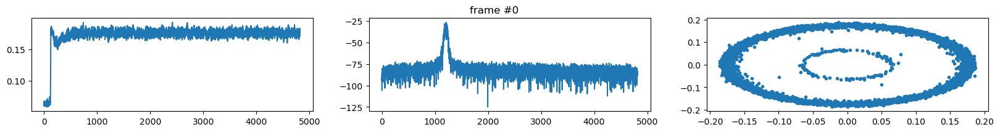

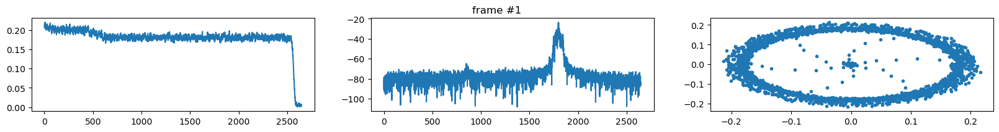

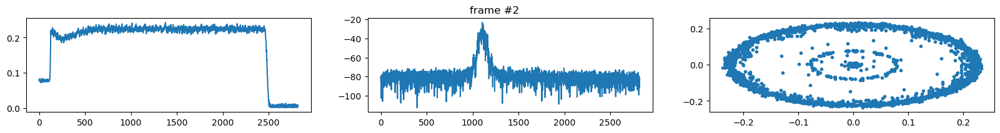

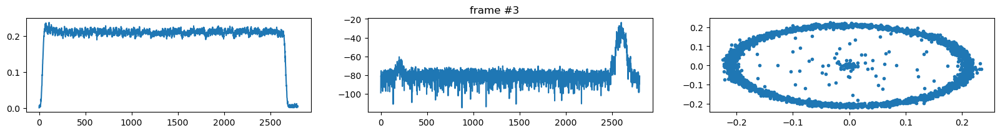

...

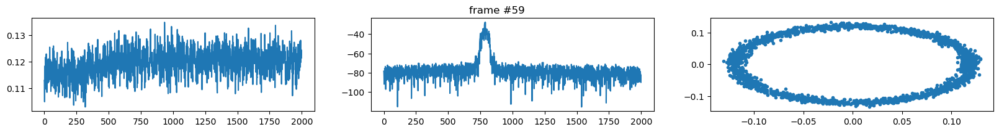

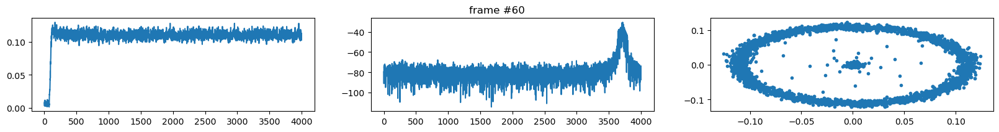

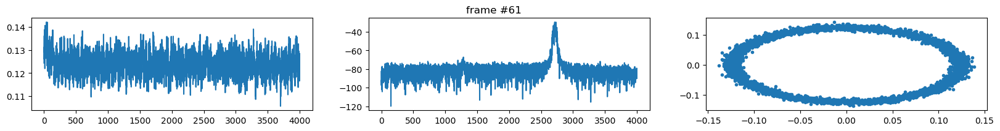

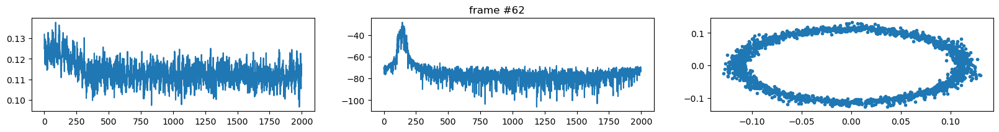

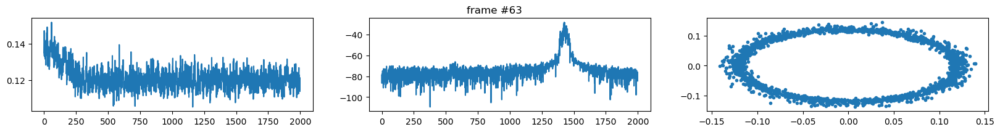

KeyboardInterrupt: 

In [15]:
samples = {}
folder = "\\DataSet\\ring\\"
for iq in getIQ(os.getcwd()+folder):
    samples[iq] = np.fromfile(os.getcwd()+folder+iq, np.complex64) # Read in file.  We have to tell it what format it is
for iq in samples:
    TotalFramesIndex = frameFinder(samples[iq])
    print(iq,": ",len(TotalFramesIndex))
    timeDomainPlotter(samples[iq],iq)